In [12]:
### Prerna Singh 4/22
# 
# Isolate cell regions and non-cell regions for given 3D sliced Clarity images of the brain
#

#import scipy.io
import numpy as np
import os
import PIL
from PIL import Image
import matplotlib.pyplot as plt
import random
import csv
import pandas as pd
import cv2

In [13]:
#image source path
file_path_img = os.path.join('10R_bias_corrected')
list = os.listdir(file_path_img)

#preprocess the csv with file labels
fileLabelCSV = pd.read_csv('ENTANGLtrainingdata/E10R-training.csv')

#make ordered lists of each coordinate dimension
xfileLabelCSV=(fileLabelCSV['Center of Mass (Geometry): X (px)']).to_list()
yfileLabelCSV=(fileLabelCSV['Center of Mass (Geometry): Y (px)']).to_list()
zfileLabelCSV=(fileLabelCSV['Center of Mass (Geometry): Z (px)']).to_list()
      
ROI = np.zeros((len(xfileLabelCSV),12,12,12))

#measured cells on neuroglancer and found that none were over 10 voxels
#create a list of ranges +-6 from the cell coordinate that are invalid when accumulating non-cell regions
x_invalid=[]
y_invalid=[]
z_invalid=[]
for index0 in range(0,len(xfileLabelCSV)):
    voxel = np.zeros((12,12,12))
    #current coordinates
    xcoord = int(xfileLabelCSV[index0])
    ycoord = int(yfileLabelCSV[index0])
    zcoord = int(zfileLabelCSV[index0])
    
    #for the ncrs
    x_invalid+=[*range(int(xfileLabelCSV[index0])-6,int(xfileLabelCSV[index0])+6)]
    y_invalid+=[*range(int(yfileLabelCSV[index0])-6,int(yfileLabelCSV[index0])+6)]
    z_invalid+=[*range(int(zfileLabelCSV[index0])-6,int(zfileLabelCSV[index0])+6)]
    
    #for every z, append the x&ys
    for index, i in enumerate(range(zcoord-6,zcoord+6)):
        for file in list:
            if str("tif") in str(file):
                if str(i) in str(file).split("_")[7]:
                    scan1 = np.asarray(Image.open(file_path_img + '/'+file))
                    scan = np.zeros(scan1.shape)
                    scan = cv2.normalize(scan1,scan, 0, 255, cv2.NORM_MINMAX)
                    plane = scan[xcoord-6:xcoord+6,ycoord-6:ycoord+6]
        voxel[index]=np.asarray(plane)
    ROI[index0]=np.asarray(voxel)


print('Total number of CellRegions: ', len(zfileLabelCSV))

Total number of CellRegions:  163


In [141]:
np.save('ROI.npy', ROI)

In [112]:
#export cell coordinates as .npy
xcoordinate=(fileLabelCSV['Center of Mass (Geometry): X (px)']).to_numpy()
ycoordinate=(fileLabelCSV['Center of Mass (Geometry): Y (px)']).to_numpy()
zcoordinate=(fileLabelCSV['Center of Mass (Geometry): Z (px)']).to_numpy()

In [22]:
#number of non-coding regions we want to isolate, lets say 515, same as number of cell regions
nNCMB = len(zfileLabelCSV)*10
NCR = []

#have 11 different coordinates for 1 non-cell region
for index0 in range(0,len(xfileLabelCSV)):
    #current coordinates
    xcoord = int(xfileLabelCSV[index0])
    ycoord = int(yfileLabelCSV[index0])
    zcoord = int(zfileLabelCSV[index0])
    ncrcell=[]
    while (len(ncrcell)) < 10:
        x_random = random.randint(xcoord-20,xcoord+20)
        y_random = random.randint(ycoord-20,ycoord+20)
        z_random = random.randint(zcoord-20,zcoord+20)
        proceed =1
        #print("Random x,y,z for Non CMB Region:", x_random,y_random,z_random)

        for i in x_invalid:
            if x_random == i:
                #print('x_false')
                proceed = 0
        for i in y_invalid:
            if y_random == i:
                #print('y_false')
                proceed = 0
        for i in z_invalid:
            if z_random == i:
                #print('z_false')
                proceed = 0

        if proceed == 1:
            #print("proceeding")
            ncrcell.append([x_random,y_random,z_random])
    for i in ncrcell:
        NCR.append(i)
print("%s non-CMB regions were isolated." %(len(NCR)), "Adding to the master dictionary.")

KeyboardInterrupt: 

In [145]:
NCR_total = np.zeros((len(NCR),12,12,12))

for index0 in range(0,len(NCR)):
    voxel = np.zeros((12,12,12))
    
    #current coordinates
    xcoord = int(NCR[index0][0])
    ycoord = int(NCR[index0][1])
    zcoord = int(NCR[index0][2])

    #for every z, append the x&ys
    for index,i in enumerate(range(zcoord-6,zcoord+6)):
        for file in list:
            if str("tif") in str(file):
                if str(i) in str(file).split("_")[7]:
                    scan1 = np.asarray(Image.open(file_path_img + '/'+file))
                    scan = np.zeros(scan1.shape)
                    scan = cv2.normalize(scan1,scan, 0, 255, cv2.NORM_MINMAX)
                    plane = scan[xcoord-6:xcoord+6,ycoord-6:ycoord+6]
        voxel[index] = np.asarray(plane)
    NCR_total[index0]=np.asarray(voxel)

In [148]:
np.save('NCR.npy',np.asarray(NCR_total))

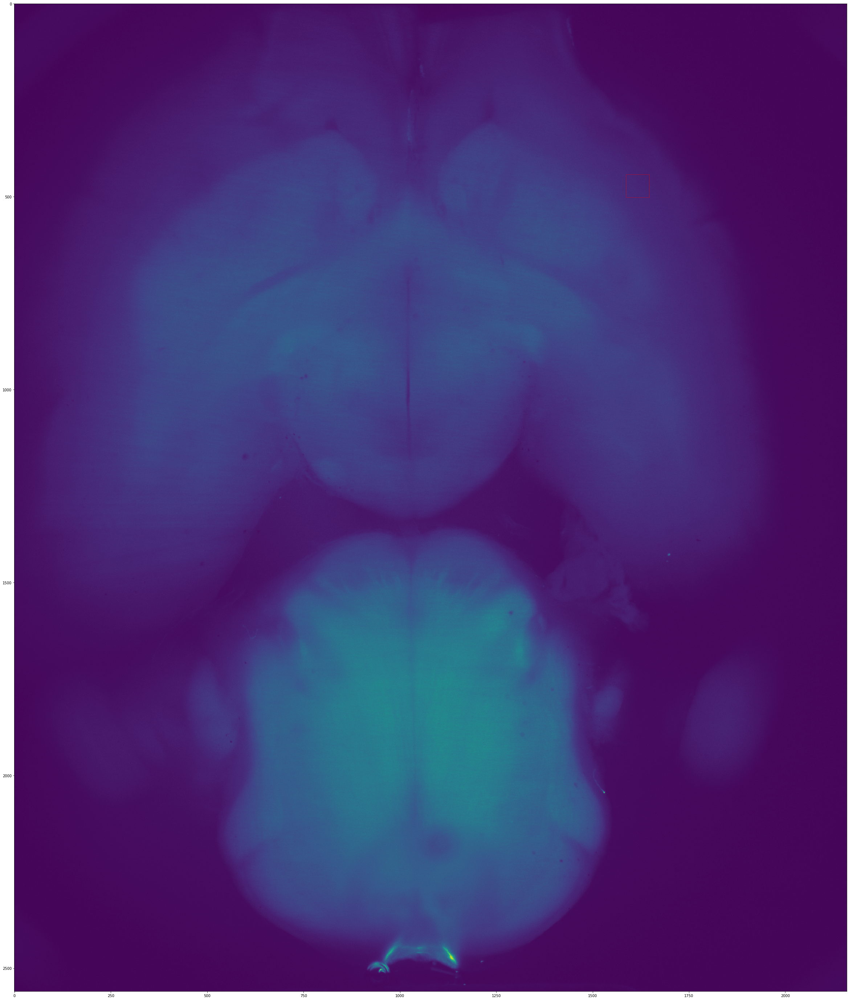

In [221]:
#minimum tensor value for training data ROI

import matplotlib.patches as patches

scan1 = np.asarray(Image.open(file_path_img + '/brian-dev_180702_ENTANGLaGFP-6L_Ch0_647_x0-2160_y0-2560_z0417.tif'))
scan = cv2.normalize(scan1,scan, 0, 255, cv2.NORM_MINMAX)
fig,ax = plt.subplots(1)

# Display the image
ax.imshow(scan)

rect = patches.Rectangle((1587,442),60,60,linewidth=.5,edgecolor='r',facecolor='none')

# Add the patch to the Axes
ax.add_patch(rect)
fig.set_size_inches(50, 50)

plt.show()

In [173]:
xfileLabelCSV[262]

1228.5

In [174]:
yfileLabelCSV[262]

629.5

In [175]:
zfileLabelCSV[262]

368

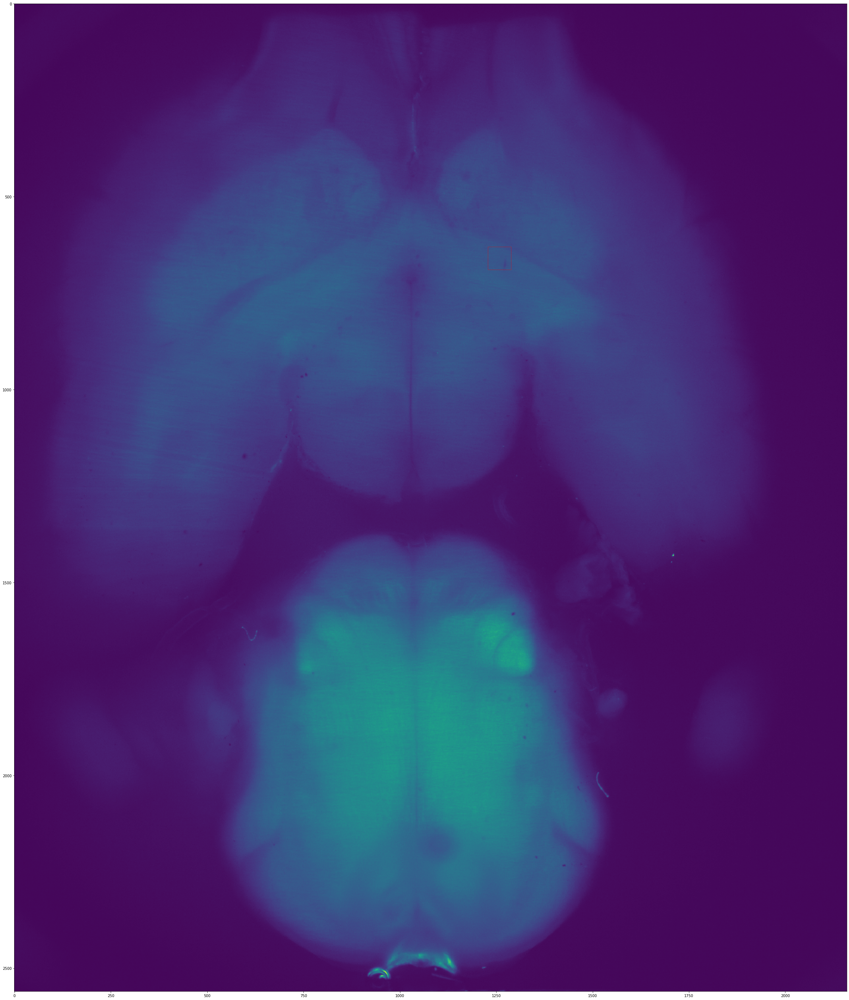

In [220]:
#max tensor
import matplotlib.patches as patches

scan1 = np.asarray(Image.open(file_path_img + '/brian-dev_180702_ENTANGLaGFP-6L_Ch0_647_x0-2160_y0-2560_z0368.tif'))
scan = cv2.normalize(scan1,scan, 0, 255, cv2.NORM_MINMAX)
fig,ax = plt.subplots(1)

# Display the image
ax.imshow(scan)

rect = patches.Rectangle((1228.5,629.5),60,60,linewidth=.5,edgecolor='r',facecolor='none')

# Add the patch to the Axes
ax.add_patch(rect)
fig.set_size_inches(50, 50)

plt.show()

In [213]:
xfileLabelCSV[479]

1576.0

In [214]:
yfileLabelCSV[479]

1774.0

In [215]:
zfileLabelCSV[479]

487

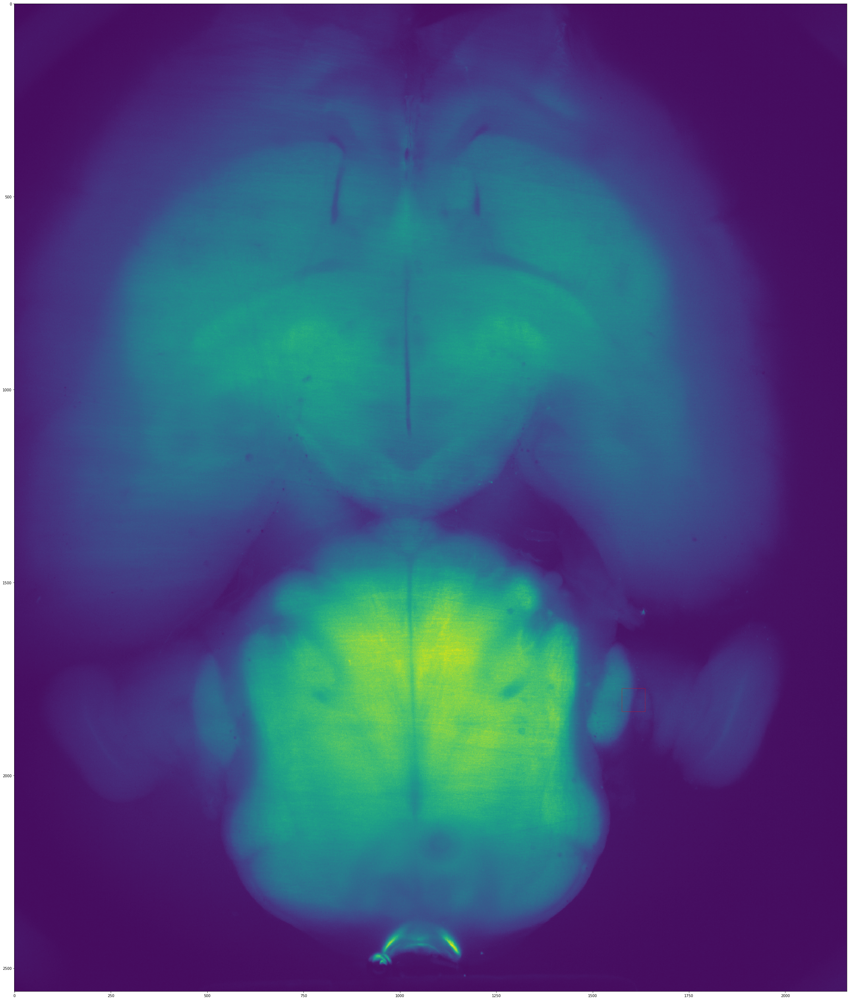

In [216]:
import matplotlib.patches as patches

scan1 = np.asarray(Image.open(file_path_img + '/brian-dev_180702_ENTANGLaGFP-6L_Ch0_647_x0-2160_y0-2560_z0487.tif'))
scan = cv2.normalize(scan1,scan, 0, 255, cv2.NORM_MINMAX)
fig,ax = plt.subplots(1)

# Display the image
ax.imshow(scan)

rect = patches.Rectangle((1576.0,1774.0),60,60,linewidth=.5,edgecolor='r',facecolor='none')

# Add the patch to the Axes
ax.add_patch(rect)
fig.set_size_inches(50, 50)

plt.show()

In [225]:
xfileLabelCSV[479]

1576.0

In [226]:
yfileLabelCSV[479]

1774.0

In [227]:
zfileLabelCSV[479]

487